In [1]:
%matplotlib inline
import pandas as pd

In [2]:
cora_pre=pd.read_pickle("./result/cora_pre/cora_pre.pkl")

In [3]:
cora_pre

{'X': tensor([[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]),
 'A': tensor(indices=tensor([[   0,    8,   14,  ..., 1389, 2344, 2707],
                        [   0,    0,    0,  ..., 2707, 2707, 2707]]),
        values=tensor([0.1667, 0.1667, 0.0913,  ..., 0.2236, 0.3536, 0.2500]),
        size=(2708, 2708), nnz=13264, layout=torch.sparse_coo),
 'S': None,
 'index_id_map': {0: 31336,
  1: 1061127,
  2: 1106406,
  3: 13195,
  4: 37879,
  5: 1126012,
  6: 1107140,
  7: 1102850,
  8: 31349,
  9: 1106418,
  10: 1123188,
  11: 1128990,
  12: 109323,
  13: 217139,
  14: 31353,
  15: 32083,
  16: 1126029,
  17: 1118017,
  18: 49482,
  19: 753265,
  20: 249858,
  21: 1113739,
  22: 48766,
  23: 646195,
  24: 1126050,
  25: 59626,
  26: 340299,
  27: 354004,
  28: 242637,
  29: 1106492,
  30:

In [4]:
cora_pre.keys()

dict_keys(['X', 'A', 'S', 'index_id_map', 'edges', 'raw_embeddings', 'wl_embedding', 'hop_embeddings', 'int_embeddings', 'y', 'idx', 'idx_train', 'idx_test', 'idx_val'])

In [7]:
cora_pre['raw_embeddings'].numpy().shape

(2708, 8, 1433)

In [8]:
fea=cora_pre['X'].numpy()
adj=cora_pre['A']
labels=cora_pre['y'].numpy()
idx=cora_pre['idx']
idx_train=cora_pre['idx_train'].numpy()
idx_test=cora_pre['idx_test'].numpy()
idx_val=cora_pre['idx_val'].numpy()

In [9]:
#torch sparse_coo稀疏矩阵恢复为完整的二维tensor
adj=adj.to_dense()

In [10]:
adj=adj.numpy()

In [11]:
adj,adj.shape

(array([[0.16666667, 0.        , 0.        , ..., 0.        , 0.        ,
         0.        ],
        [0.        , 0.5       , 0.        , ..., 0.        , 0.        ,
         0.        ],
        [0.        , 0.        , 0.2       , ..., 0.        , 0.        ,
         0.        ],
        ...,
        [0.        , 0.        , 0.        , ..., 0.2       , 0.        ,
         0.        ],
        [0.        , 0.        , 0.        , ..., 0.        , 0.2       ,
         0.        ],
        [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
         0.25      ]], dtype=float32),
 (2708, 2708))

In [12]:
from scipy import sparse
adj=sparse.csr_matrix(adj)

In [13]:
fea.shape,adj.shape,labels.shape,idx.shape,idx_train.shape,idx_test.shape,idx_val.shape

((2708, 1433), (2708, 2708), (2708,), (2708,), (140,), (1000,), (300,))

# idx train+test+val一共1500个，所以这个代码没有用到全体数据集（2708个）

和GAT一致：
idx_train = range(140) 140
idx_val = range(200, 500) 300
idx_test = range(500, 1500) 1000

In [15]:
idx_train

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139])

In [21]:
idx_test,idx_test.shape

(array([ 200,  201,  202,  203,  204,  205,  206,  207,  208,  209,  210,
         211,  212,  213,  214,  215,  216,  217,  218,  219,  220,  221,
         222,  223,  224,  225,  226,  227,  228,  229,  230,  231,  232,
         233,  234,  235,  236,  237,  238,  239,  240,  241,  242,  243,
         244,  245,  246,  247,  248,  249,  250,  251,  252,  253,  254,
         255,  256,  257,  258,  259,  260,  261,  262,  263,  264,  265,
         266,  267,  268,  269,  270,  271,  272,  273,  274,  275,  276,
         277,  278,  279,  280,  281,  282,  283,  284,  285,  286,  287,
         288,  289,  290,  291,  292,  293,  294,  295,  296,  297,  298,
         299,  300,  301,  302,  303,  304,  305,  306,  307,  308,  309,
         310,  311,  312,  313,  314,  315,  316,  317,  318,  319,  320,
         321,  322,  323,  324,  325,  326,  327,  328,  329,  330,  331,
         332,  333,  334,  335,  336,  337,  338,  339,  340,  341,  342,
         343,  344,  345,  346,  347, 

In [20]:
idx_val,idx_val.shape

(array([1200, 1201, 1202, 1203, 1204, 1205, 1206, 1207, 1208, 1209, 1210,
        1211, 1212, 1213, 1214, 1215, 1216, 1217, 1218, 1219, 1220, 1221,
        1222, 1223, 1224, 1225, 1226, 1227, 1228, 1229, 1230, 1231, 1232,
        1233, 1234, 1235, 1236, 1237, 1238, 1239, 1240, 1241, 1242, 1243,
        1244, 1245, 1246, 1247, 1248, 1249, 1250, 1251, 1252, 1253, 1254,
        1255, 1256, 1257, 1258, 1259, 1260, 1261, 1262, 1263, 1264, 1265,
        1266, 1267, 1268, 1269, 1270, 1271, 1272, 1273, 1274, 1275, 1276,
        1277, 1278, 1279, 1280, 1281, 1282, 1283, 1284, 1285, 1286, 1287,
        1288, 1289, 1290, 1291, 1292, 1293, 1294, 1295, 1296, 1297, 1298,
        1299, 1300, 1301, 1302, 1303, 1304, 1305, 1306, 1307, 1308, 1309,
        1310, 1311, 1312, 1313, 1314, 1315, 1316, 1317, 1318, 1319, 1320,
        1321, 1322, 1323, 1324, 1325, 1326, 1327, 1328, 1329, 1330, 1331,
        1332, 1333, 1334, 1335, 1336, 1337, 1338, 1339, 1340, 1341, 1342,
        1343, 1344, 1345, 1346, 1347, 

In [19]:
cora_pre['raw_embeddings'][idx_val].shape

torch.Size([300, 8, 1433])

In [32]:
import numpy as np
import scipy.sparse as sp
from bokeh.palettes import Category20_20, Category20b_20, Accent8
from matplotlib import collections  as mc
import matplotlib.pyplot as plt


def plot_graph_embedding(y_emb, labels, adj, line_alpha=0.2, s=7, title=""):
    """
    Plots the visualization of graph-structured data
    Args:
        y_emb (np.array): low dimensional map of data points, matrix of size n x 2
        labels (np.array): underlying class labels, matrix of size n x 1
        adj (scipy csr matrix): adjacency matrix
    """
    labels = np.array([int(l) for l in labels])
    adj = sp.coo_matrix(adj)

    colormap = np.array(Category20_20 + Category20b_20 + Accent8)

    f, ax = plt.subplots(1, sharex='col', figsize=(6, 4), dpi=800)

    ax.set_axis_off()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    ax.set_title(title)

    # Plot edges
    p0 = y_emb[adj.row, :]
    p1 = y_emb[adj.col, :]
    p_0 = [tuple(row) for row in p0]
    p_1 = [tuple(row) for row in p1]

    classA = labels[adj.row]
    classB = labels[adj.col]
    mask = classA == classB
    edge_colormask = mask * (classA + 1) - 1

    lines = list(zip(p_0, p_1))
    lc = mc.LineCollection(lines, linewidths=0.5, colors=colormap[edge_colormask])
    lc.set_alpha(line_alpha)
    ax.add_collection(lc)

    ax.scatter(y_emb[:, 0], y_emb[:, 1], s=s, c=colormap[labels])

    ax.margins(0.1, 0.1)
    plt.autoscale(tight=True)
    plt.tight_layout()

In [33]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
tsne =TSNE(n_components=2, init='pca', random_state=0)
'''n_components维度降为2维,init设置embedding的初始化方式，可选random或者pca'''
fea_tsne = tsne.fit_transform(fea)
fea_pca = PCA().fit_transform(fea)

In [38]:
fea.shape,fea_tsne.shape,fea_pca.shape

((2708, 1433), (2708, 2), (2708, 1433))

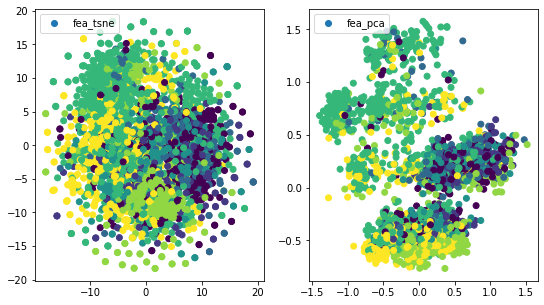

In [34]:
plt.figure(figsize=(9, 5))
plt.subplot(121)
plt.scatter(fea_tsne[:, 0], fea_tsne[:, 1],c=labels,label='fea_tsne')
plt.legend(loc='upper left')
plt.subplot(122)
plt.scatter(fea_pca[:, 0], fea_pca[:, 1], c=labels,label='fea_pca')
plt.legend(loc='upper left')
plt.show()

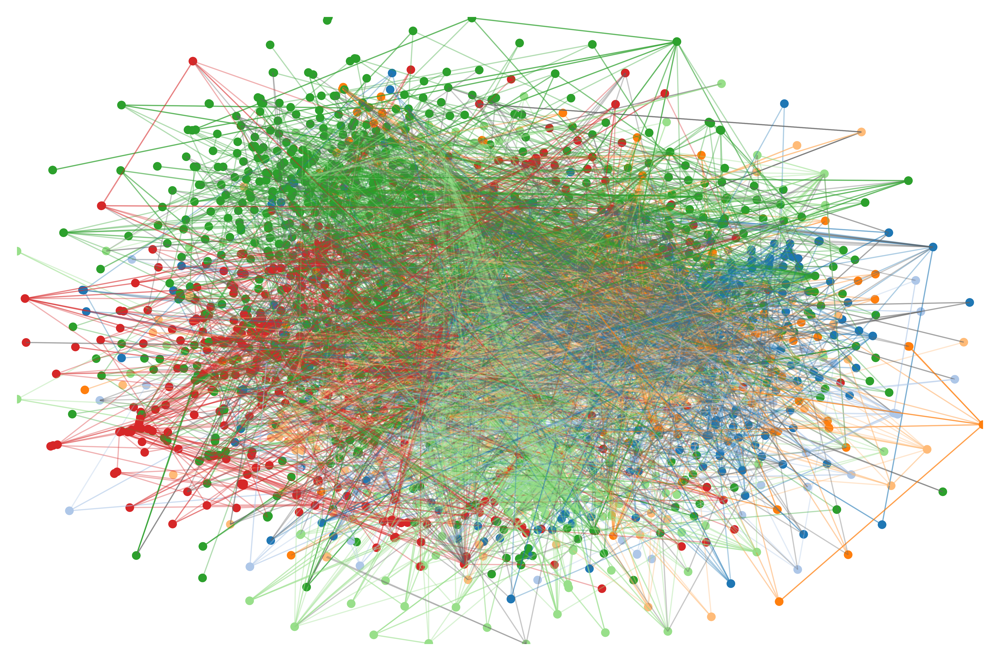

In [35]:
plot_graph_embedding(fea_tsne,labels,adj)

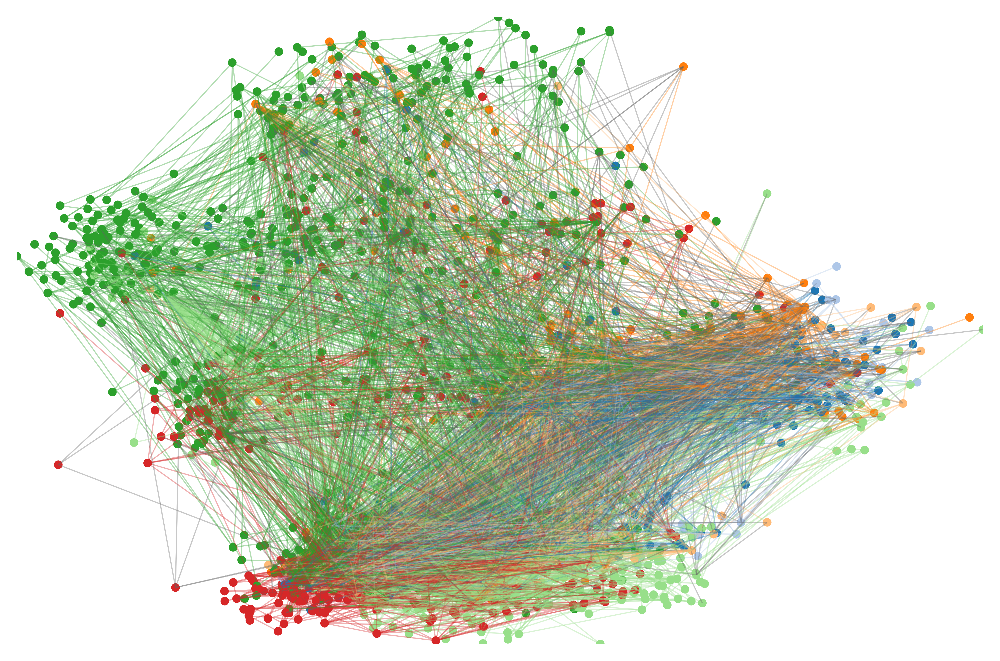

In [36]:
plot_graph_embedding(fea_pca[:,:2],labels,adj)

In [37]:
fea_pca

array([[-3.09638888e-01, -5.82358122e-01, -1.04210578e-01, ...,
         3.89983924e-03, -1.39060717e-07, -2.32609021e-09],
       [ 9.14533675e-01,  3.04174453e-01,  2.51012385e-01, ...,
         1.59672566e-03,  4.76993200e-08, -2.56409782e-09],
       [ 7.02467203e-01,  3.55975688e-01,  2.12144345e-01, ...,
        -4.33072494e-03,  1.56928937e-09, -2.17435916e-10],
       ...,
       [ 1.99947134e-01, -6.18686557e-01,  4.87566411e-01, ...,
         5.79087110e-03,  1.43730565e-08,  2.40012499e-09],
       [-2.66535401e-01, -4.32540178e-01, -3.71574424e-02, ...,
         3.23186512e-03,  1.83207471e-09,  1.68200764e-09],
       [-1.08473420e+00,  8.07585299e-01,  4.50621918e-02, ...,
        -1.15569774e-03,  2.28089925e-09,  4.85472951e-09]], dtype=float32)